### Project name: 
The Real zodiac

### Problem definition:
There are many visible stars, but nowadays astrology uses only a few of them to predict the characters and the future of the 12 types of people, categorized by their Zodiac signs. 

### Hypothesis:
Instead of the constellations through the Ecliptic, is it possible astrology to use different stars that are near to the Celestial equator, in order to predict our future with even better accuracy and efficiency? 

### Goal:
This project aims to mend astrology, creating new zodiac signs, that are going to serve the society and no amount of science is going to be left behind.
In the New Zodiac each sign will occupy around 30° right ascension and ±5° declination on the Equatorial coordinate system. Only the stars brighter than magnitude +6.0 will take part in determining the future of the human species.

### Data preparation:
0. "The HYG Database", version “HYG 3.0”, contains almost 120,000 stars - all stars in Hipparcos, Yale Bright Star, and Gliese catalogs.
1. Unnecessary columns are removed, also all rows, containing stars with magnitude more than 6, because they are not bright enough to be observed with unarmed eye. => 1,137 stars remains.
2. In its final version the database is reduced to ±5° angle of declination (Dec). In the conventional zodiac constellations the scope is around 30° and that is too much for me, so I choose three times smaller scope. => 372 stars remains.

In [16]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import AgglomerativeClustering, KMeans
from scipy.cluster.hierarchy import linkage, dendrogram
from IPython.display import Image, display

In [17]:
# The .csv file is previously analysed and prepared.
# removed colums: many
# removed rows: all with values above 5 and below -5 degrees "dec"

stars_features = pd.read_csv("D:\SoftUni\Machine Learning\The Bulgarian Zodiac Project\\HYG Database_final.csv")
stars_features.head()

,id,proper,ra,dec,dist,mag
0,145,NaN,0.030402,-3.027504,139.2758,5.13
1,2000,NaN,0.423391,1.939692,144.0922,5.77
2,2347,NaN,0.500655,-3.957332,173.9130,5.72
3,2756,NaN,0.587466,-3.592846,21.2540,5.20
4,2781,NaN,0.592454,-0.505610,54.4959,5.94


In [18]:
# Only 372 rows remains.

stars_features.shape

(372, 6)

In [19]:
# Right ascension and Declination -> for the scattering

coordinates = stars_features[["ra", "dec"]]
coordinates.head()

,ra,dec
0,0.030402,-3.027504
1,0.423391,1.939692
2,0.500655,-3.957332
3,0.587466,-3.592846
4,0.592454,-0.505610


In [20]:
# Right ascension -> for the clustering

ra = coordinates[["ra"]]
ra.head()

,ra
0,0.030402
1,0.423391
2,0.500655
3,0.587466
4,0.592454


In [21]:
# Converting objects to NumPy arrays

coordinates = np.array(coordinates)
ra = np.array(ra)

In [8]:
# Using Hierarchical clustering algorithm:

aggl = AgglomerativeClustering(n_clusters = 12, linkage = "complete")
aggl_clusters = aggl.fit_predict(ra)
aggl_clusters

array([ 8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0

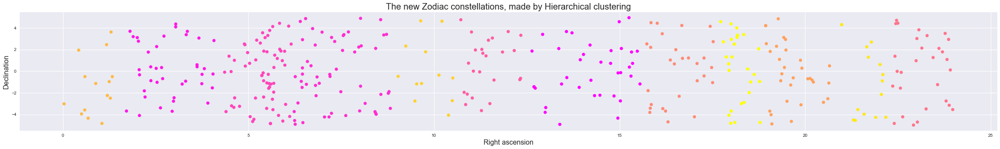

In [11]:
fig = plt.figure(figsize=(40,5))
plt.scatter(coordinates[:, 0], coordinates[:, 1], c = aggl_clusters, cmap=plt.cm.spring)
plt.title('The new Zodiac constellations, made by Hierarchical clustering', fontsize=20)
plt.xlabel('Right ascension', fontsize=16)
plt.ylabel('Declination', fontsize=16)
plt.show()

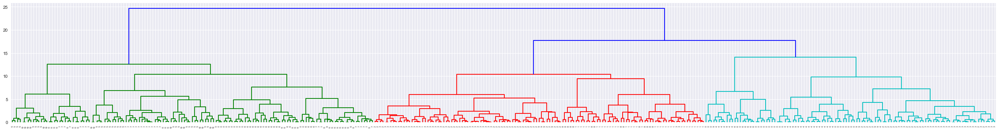

In [37]:
# Plotting dendrogram for the hierarchical clustering results 

fig = plt.figure(figsize=(40,5))
row_clusters = linkage(coordinates, method = "complete", metric = "euclidean")
row_dendr = dendrogram(row_clusters, labels = aggl_clusters)

In [63]:
# Applying K-Means++ algorithm:

kmeans = KMeans(12, init="k-means++")
kmeans_clusters = kmeans.fit_predict(ra)
kmeans_clusters

array([ 3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,
        6,  6,  6,  6,  6,  6,  6,  6,  6,  6, 11, 11, 11, 11, 11, 11, 11,
       11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11,
       11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11,
       11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  2

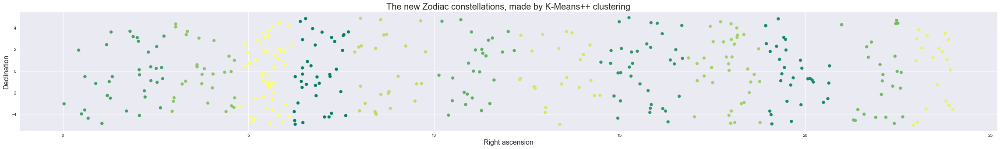

In [90]:
# Plotting K-Means++ clustering result on coordinates[ra, dec]

fig = plt.figure(figsize=(40,5))
plt.scatter(coordinates[:, 0], coordinates[:, 1], c = kmeans_clusters, cmap=plt.cm.summer)
plt.title('The new Zodiac constellations, made by K-Means++ clustering', fontsize=20)
plt.xlabel('Right ascension', fontsize=16)
plt.ylabel('Declination', fontsize=16)
plt.show()

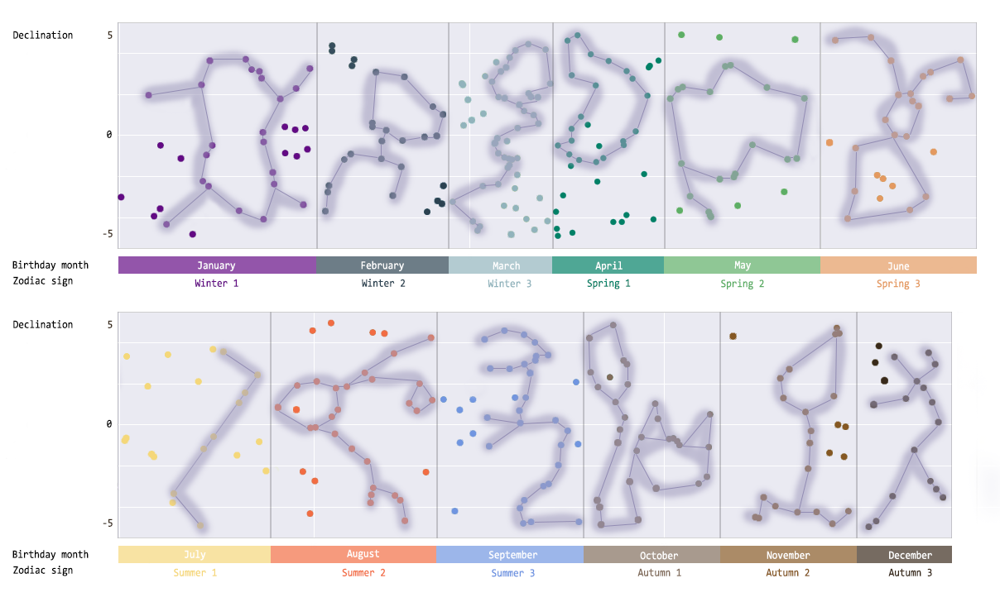

In [4]:
# In the image below:
# boundaries of the 12 clusters are drawn (only one point is removed);
# random points are connected manually in order to create the new zodiac constellations;
# names and labels are written for the real zodiac signs.

real_signs = Image(filename='D:\SoftUni\Machine Learning\Images\\50_Real zodiac signs.png')
real_signs

Please enter your birthday month: November

Your real zodiac sign Autumn 2.


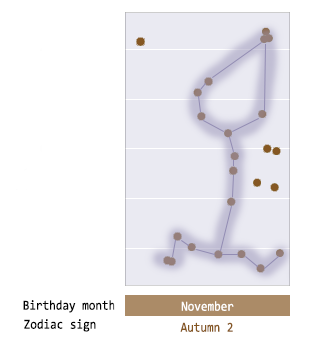

In [23]:
# Interaction with the user, applying input of birth month and displaying output - accurate zodiac sign. 

birth_month = input('Please enter your birthday month: ')

winter1 = Image(filename='D:\SoftUni\Machine Learning\Images\Winter1.png')
winter2 = Image(filename='D:\SoftUni\Machine Learning\Images\Winter2.png')
winter3 = Image(filename='D:\SoftUni\Machine Learning\Images\Winter3.png')
spring1 = Image(filename='D:\SoftUni\Machine Learning\Images\Spring1.png')
spring2 = Image(filename='D:\SoftUni\Machine Learning\Images\Spring2.png')
spring3 = Image(filename='D:\SoftUni\Machine Learning\Images\Spring3.png')
summer1 = Image(filename='D:\SoftUni\Machine Learning\Images\Summer1.png')
summer2 = Image(filename='D:\SoftUni\Machine Learning\Images\Summer2.png')
summer3 = Image(filename='D:\SoftUni\Machine Learning\Images\Summer3.png')
autumn1 = Image(filename='D:\SoftUni\Machine Learning\Images\Autumn1.png')
autumn2 = Image(filename='D:\SoftUni\Machine Learning\Images\Autumn2.png')
autumn3 = Image(filename='D:\SoftUni\Machine Learning\Images\Autumn3.png')

if birth_month == "January": 
    print('\nYour real zodiac sign Winter 1.')
    display(winter1)
elif birth_month == "February":
    print('\nYour real zodiac sign Winter 2.')
    display(winter2)
elif birth_month == "March":
    print('\nYour real zodiac sign Winter 3.')
    display(winter3)
elif birth_month == "April":
    print('\nYour real zodiac sign Spring 1.')
    display(spring1)
elif birth_month == "May": 
    print('\nYour real zodiac sign Spring 2.')
    display(spring2)
elif birth_month == "June": 
    print('\nYour real zodiac sign Spring 3.')
    display(spring3)
elif birth_month == "July": 
    print('\nYour real zodiac sign Summer 1.')
    display(summer1)
elif birth_month == "August": 
    print('\nYour real zodiac sign Summer 2.')
    display(summer2)
elif birth_month == "September": 
    print('\nYour real zodiac sign Summer 3.')
    display(summer3)
elif birth_month == "October":
    print('\nYour real zodiac sign Autumn 1.')
    display(autumn1)
elif birth_month == "November": 
    print('\nYour real zodiac sign Autumn 2.')
    display(autumn2)
elif birth_month == "December":
    print('\nYour real zodiac sign Autumn 3.')
    display(autumn3)
else: print(input('Your input is wrong. Plese write your birthday month in English, with capital letter:'))

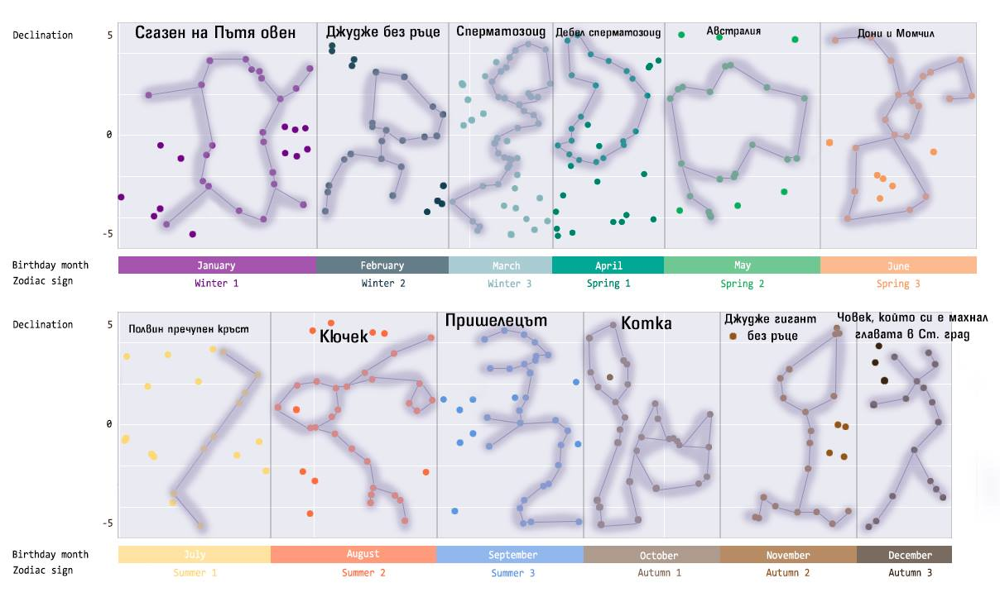

In [6]:
# The signs with bulgarian subtitles:
# (translated by Samuil Petkanov

real_signs_bg = Image(filename='D:\SoftUni\Machine Learning\Images\\51_Real Zodiac signs_bg.jpg')
real_signs_bg

### Results:

Best discribed in “51_Real Zodiac signs_bg.jpg”

And the answer of the project question is: 
Yes.


### Conclusion:

Our horoscopes could and should all sounds like:
“The stars and the planets will not affect your life in any way.”

### Future improvements:
    
1. To create Zodiac for Discworld.
2. To create at least per one Zodiac for all seven of TRAPPIST-1's planets.

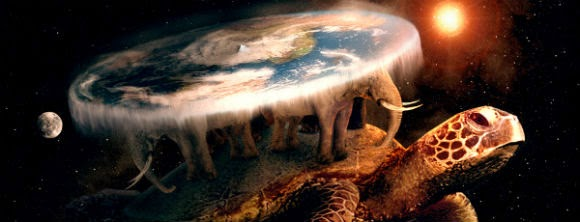

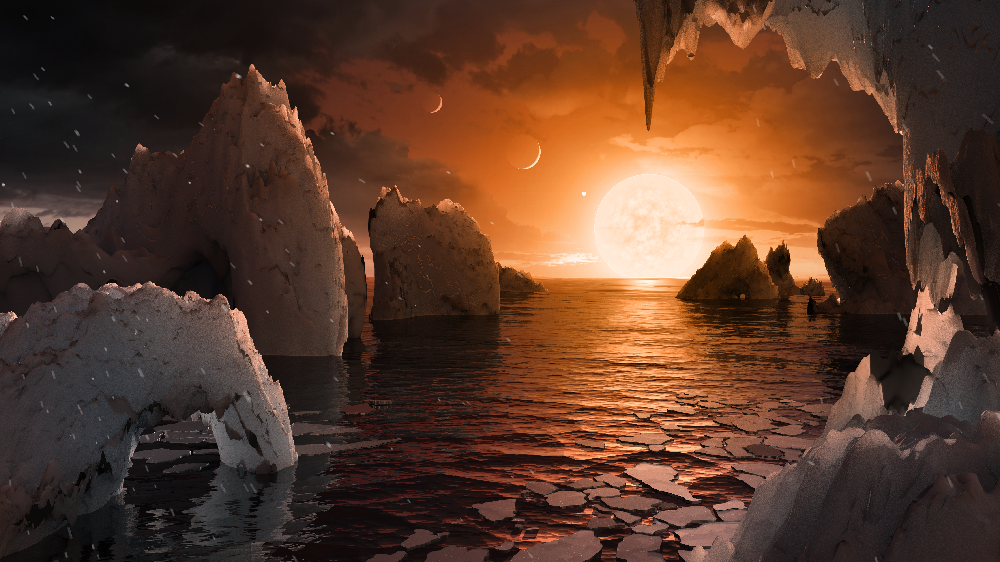

In [41]:
listOfImageNames = ['D:\SoftUni\Machine Learning\Images\\54_Discworld - Terry Pratchet.jpg',
                    'D:\SoftUni\Machine Learning\Images\\55_Trappist-1.png']

for imageName in listOfImageNames:
    display(Image(filename=imageName))